# **Spit some [tensor] flow**

Practice makes perfect

`Let's get this over with`


In [89]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
print(tf.__version__)

2.2.0


## Generative Adversarial Networks 

GANs are one of the most interesting applications of deep learning. They work in pairs; they have two sub-networks working against each other. A generative network generates fake data to fool the discriminating network. E.g., a generative network makes faces, and the discriminating network classifies if they are real people or not. 

They are called adversarial because their subunits work against each other. Let's get into the concepts of GANs. 

What loss function would the discriminator use? It has to check if the generated data is real or fake, so we'll use binary crossentropy. 

What about the generator loss? We'll just freeze the discriminator! and use the binary crossentropy loss function with labels reversed. So the generative network fools the discriminator and we ourselves fool the generative network !


## Image ====> Discriminator ====> Real or Fake? 

## Noise ====> Generator ====> Fake Image


## Let's load the dataset using keras datasets 

In [0]:
from tensorflow.keras.layers import Input, Dense, Dropout, LeakyReLU, BatchNormalization, Conv2DTranspose
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, SGD
import os
import sys

In [91]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.fashion_mnist.load_data()
X_train, X_test = X_train / 255.0 * 2 - 1 , X_test / 255.0 * 2 -1  
# SCALING BETWEEN -1 AND 1

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)


(60000, 28, 28)
(10000, 28, 28)
(60000,)
(10000,)


In [0]:
N, H, W = X_train.shape
D = H * W 

In [0]:
X_train = X_train.reshape(-1, D)
X_test = X_test.reshape(-1, D)

In [94]:
print(X_train.shape)
print(X_test.shape)

(60000, 784)
(10000, 784)


In [0]:
# Dimensionality of the latent space
LD = 200
# Reference https://www.tensorflow.org/tutorials/generative/dcgan

In [0]:
def make_generator(LD, D):
  i_layer = Input(shape=(LD,))
  h_layer = Dense(128, activation=LeakyReLU(alpha=0.2))(i_layer)
  h_layer = BatchNormalization(momentum = 0.7)(h_layer)
  h_layer = Dense(256, activation=LeakyReLU(alpha=0.2))(h_layer)
  h_layer = BatchNormalization(momentum = 0.7)(h_layer)
  h_layer = Dense(512, activation=LeakyReLU(alpha=0.2))(h_layer)
  h_layer = BatchNormalization(momentum = 0.7)(h_layer)
  h_layer = Dense(1024, activation=LeakyReLU(alpha=0.2))(h_layer)
  h_layer = BatchNormalization(momentum = 0.7)(h_layer)
  o_layer = Dense(D, activation='tanh')(h_layer)
  return Model(i_layer, o_layer)

In [0]:
def make_discriminator(D):
  i_layer = Input(shape=(D,))
  h_layer = Dense(512, activation=LeakyReLU(alpha=0.2))(i_layer)
  h_layer = Dense(1024, activation=LeakyReLU(alpha=0.2))(h_layer)
  o_layer = Dense(1, activation='sigmoid')(h_layer)
  return Model(i_layer, o_layer)
  

In [0]:
d = make_discriminator(D)

In [0]:
d.compile(loss='binary_crossentropy',
          optimizer = Adam(0.0001),
          metrics = ['accuracy'])

In [0]:
g = make_generator(LD, D)

In [0]:
noise_i_layer = Input(shape=(LD,))
image = g(noise_i_layer, D)
d.trainable = False
prediction = d(image)
gan = Model(noise_i_layer, prediction)

In [0]:
gan.compile(loss='binary_crossentropy',
          optimizer = Adam(0.0001))

In [0]:
batch_size = 64
epochs = 50000
export_period = 1000

In [0]:
ones = np.ones(batch_size)
zeros = np.zeros(batch_size)

In [0]:
d_loss_list = []
g_loss_list = []

In [0]:
if not os.path.exists('GANS'):
  os.makedirs('GANS')

In [0]:
def get_images(epochs, rows, columns, LD, g):
  noise = np.random.randn(rows * columns, LD)
  images_by_generator = g.predict(noise)
  images_by_generator = 0.5 * images_by_generator + 0.5

  fig, ax = plt.subplots(rows, columns)
  index = 0
  for i in range(rows):
    for j in range(columns):
      ax[i,j].imshow(images_by_generator[index].reshape(H,W), cmap='gray')
      ax[i,j].axis('off')
      index+=1
  fig.savefig("GANS/%d.png" % epochs)
  plt.close

d_loss = 0.8078967928886414 and g_loss = 0.632607102394104
d_loss = 0.01357427448965609 and g_loss = 5.119610786437988
d_loss = 0.07548550143837929 and g_loss = 4.555258750915527
d_loss = 0.09393633157014847 and g_loss = 4.995144844055176
d_loss = 0.11849546805024147 and g_loss = 4.845889568328857
d_loss = 0.029858488123863935 and g_loss = 4.2653350830078125
d_loss = 0.0746251568198204 and g_loss = 5.872915267944336
d_loss = 0.04897766932845116 and g_loss = 5.227434158325195
d_loss = 0.1614224538207054 and g_loss = 5.656835556030273
d_loss = 0.2167077362537384 and g_loss = 3.2513599395751953
d_loss = 0.24450582265853882 and g_loss = 3.399127960205078
d_loss = 0.3231477737426758 and g_loss = 3.1063344478607178
d_loss = 0.08905191719532013 and g_loss = 4.517467975616455
d_loss = 0.1502777524292469 and g_loss = 3.592517375946045
d_loss = 0.1628207489848137 and g_loss = 2.885056257247925
d_loss = 0.21324117481708527 and g_loss = 2.8883934020996094
d_loss = 0.3637378364801407 and g_loss = 2

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


d_loss = 0.3151371479034424 and g_loss = 2.0508058071136475
d_loss = 0.3488437980413437 and g_loss = 1.9525721073150635
d_loss = 0.37278348207473755 and g_loss = 1.725060224533081
d_loss = 0.3720838874578476 and g_loss = 2.5901241302490234
d_loss = 0.3110658526420593 and g_loss = 2.8744773864746094
d_loss = 0.4219778925180435 and g_loss = 2.159484624862671
d_loss = 0.39004209637641907 and g_loss = 1.8675451278686523
d_loss = 0.6033413261175156 and g_loss = 2.662802219390869
d_loss = 0.4144047945737839 and g_loss = 1.866377830505371
d_loss = 0.42810310423374176 and g_loss = 1.8650861978530884
d_loss = 0.4367925077676773 and g_loss = 1.6372759342193604
d_loss = 0.5185976326465607 and g_loss = 1.646979808807373
d_loss = 0.43581870198249817 and g_loss = 1.7821037769317627
d_loss = 0.6121073663234711 and g_loss = 1.5239546298980713
d_loss = 0.47195495665073395 and g_loss = 1.5544205904006958
d_loss = 0.6352157890796661 and g_loss = 1.3245649337768555
d_loss = 0.6010527461767197 and g_loss =

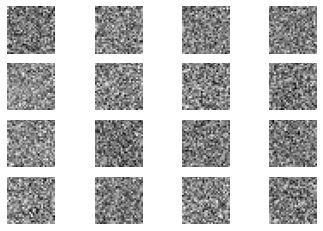

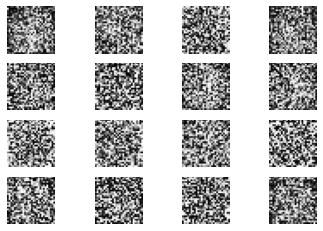

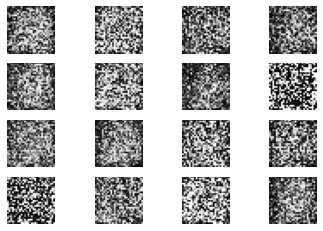

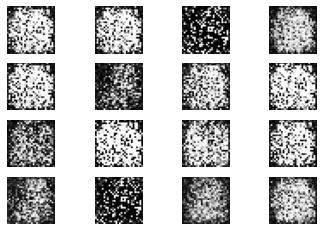

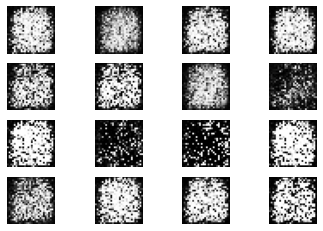

...

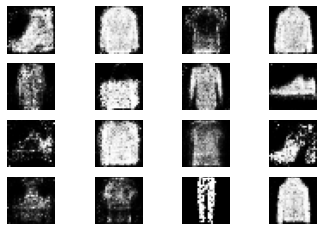

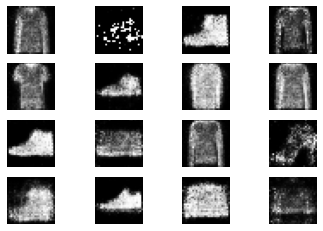

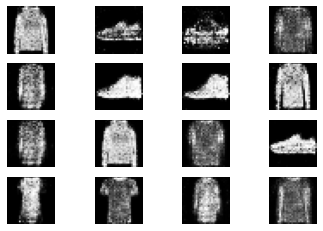

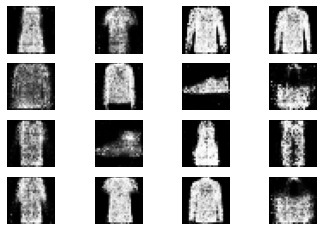

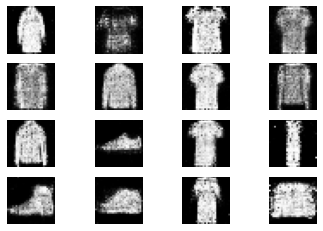

In [108]:
for e in range(epochs):
  index = np.random.randint(0, X_train.shape[0], batch_size)
  real = X_train[index]

  noise = np.random.randn(batch_size, LD)
  fake = g.predict(noise)

  d_loss_real, d_accuracy_real = d.train_on_batch(real, ones)
  d_loss_fake, d_accuracy_fake= d.train_on_batch(fake, zeros)
  d_loss = (d_loss_real + d_loss_fake) * 1/2 
  d_accuracy = (d_loss_real + d_loss_fake) * 1/2


  noise = np.random.randn(batch_size, LD)
  g_loss = gan.train_on_batch(noise, ones)

  d_loss_list.append(d_loss)
  g_loss_list.append(g_loss)

  if e % 200 == 0:
    print("epoch = {} d_loss = {} and g_loss = {}".format(e, d_loss, g_loss))
  if e % export_period == 0:
    get_images(e , 4,4, LD, g)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


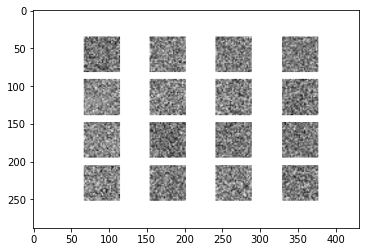

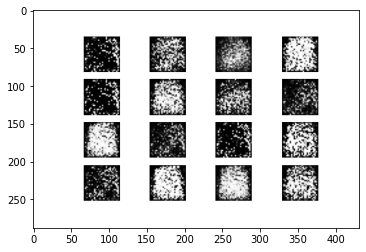

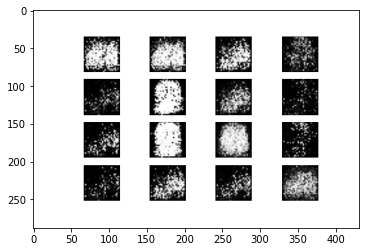

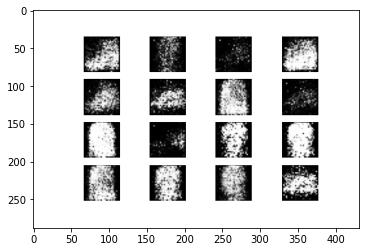

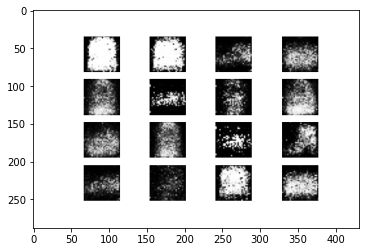

...

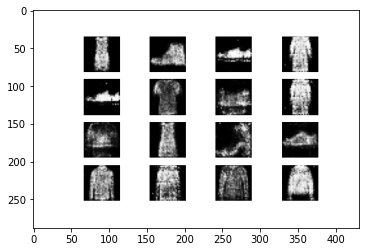

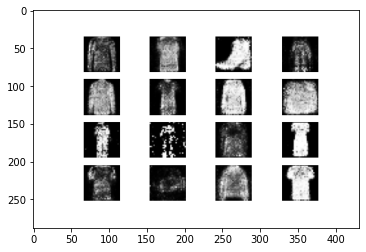

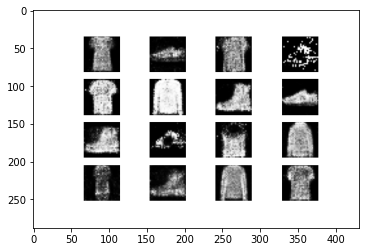

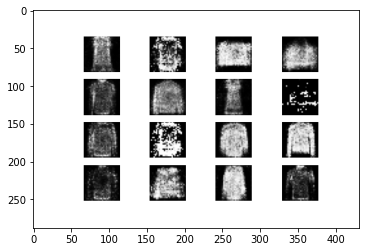

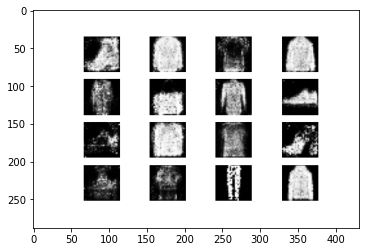

In [115]:
for i in range(epochs):
  if i % 1000 == 0:
    img = plt.imread('GANS/' + str(i) + ".png" )
    plt.figure()
    plt.imshow(img) 